In [10]:
import numpy as np
import pickle

In [11]:
from sklearn.datasets import load_iris
from sklearn import tree
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import confusion_matrix

## Load the features

In [12]:
with open('../cache/features','rb') as f:
    X, y, imgNames = pickle.load(f)
X.shape

(598, 12)

In [13]:
X

,left_minus_right,mean,middle_max,middle_minus_left,middle_minus_right,middle_n_peaks,middle_prec_raised,middle_range,middle_row_max,pre_norm_max,pre_norm_range,pre_norm_var
0,0.001482,0.650116,0.884444,0.000092,0.001391,0.0,0.003094,0.600000,0.360000,225.0,202.0,111.677355
1,0.006381,0.619079,0.885572,0.002460,0.008841,8.0,0.245000,0.646766,0.527363,201.0,193.0,375.389887
2,0.003976,0.613970,0.973451,0.004476,0.008453,5.0,0.026719,0.730088,0.376106,226.0,199.0,235.528736
3,0.004076,0.552680,0.920000,0.001505,0.002571,11.0,0.167000,0.640000,0.426667,225.0,206.0,323.269721
4,0.002386,0.619940,0.768889,0.001501,0.000885,5.0,0.000281,0.586667,0.386667,209.0,190.0,202.834792
5,0.003237,0.652965,0.805556,0.001519,0.001717,2.0,0.000812,0.518519,0.625000,216.0,200.0,182.086428
6,0.005664,0.534487,0.946903,0.001078,0.004586,14.0,0.216125,0.787611,0.473451,226.0,212.0,426.710738
7,0.002350,0.634305,0.991150,0.009170,0.011520,0.0,0.048406,0.606195,0.367257,226.0,202.0,163.758855
8,0.002007,0.673598,0.813084,0.000946,0.001061,1.0,0.000531,0.397196,0.434579,200.0,176.0,141.411245
9,0.002182,0.556852,0.729412,0.000785,0.001397,2.0,0.001313,0.498039,0.356863,219.0,195.0,183.394249


In [14]:
y.mean()

0.5635451505016722

## Evalutate a Decision Tree Model via Cross-Validation

In [15]:
clf = tree.DecisionTreeClassifier(max_depth=5, min_samples_leaf=5).fit(X, y)

In [16]:
scores = cross_val_score(clf, X, y, cv=10)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Accuracy: 0.69 (+/- 0.19)


In [17]:
y_pred = cross_val_predict(clf, X, y, cv=10)
confusion_matrix(y, y_pred)

array([[180,  81],
       [102, 235]])

In [18]:
import graphviz 
dot_data = tree.export_graphviz(clf, out_file=None, feature_names=X.columns,                             
                         filled=True, rounded=True,  
                         special_characters=True)
graph = graphviz.Source(dot_data) 
graph.render("decicition_tree") 

'decicition_tree.pdf'

## Look at bad examples

In [21]:
from PIL import Image
import imageio

def printWaterfall(file):
    im = imageio.imread(file)
    display(Image.fromarray(im))

     left_minus_right      mean  middle_max  middle_minus_left  \
252          0.001564  0.395485    0.942857           0.011487   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
252            0.013051            12.0            0.116719      0.885714   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
252        0.605714         225.0           171.0     244.61086  


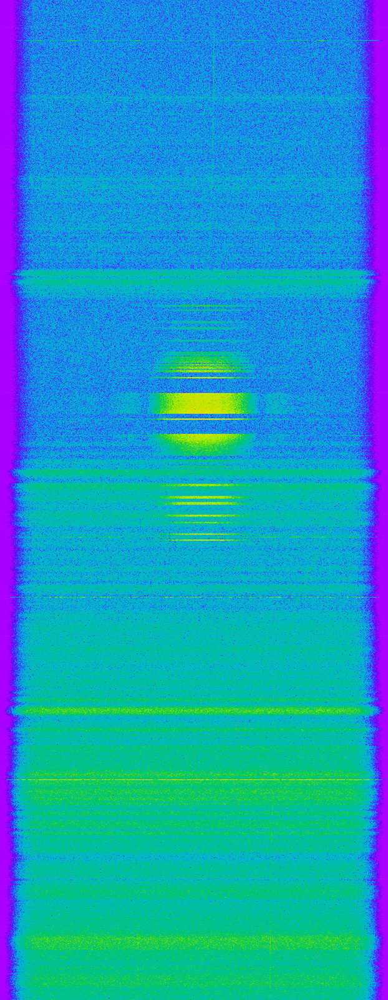

     left_minus_right      mean  middle_max  middle_minus_left  \
239          0.003963  0.577823    0.764444           0.002052   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
239            0.001911             2.0               0.149      0.564444   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
239        0.337778         175.0           170.0    311.515081  


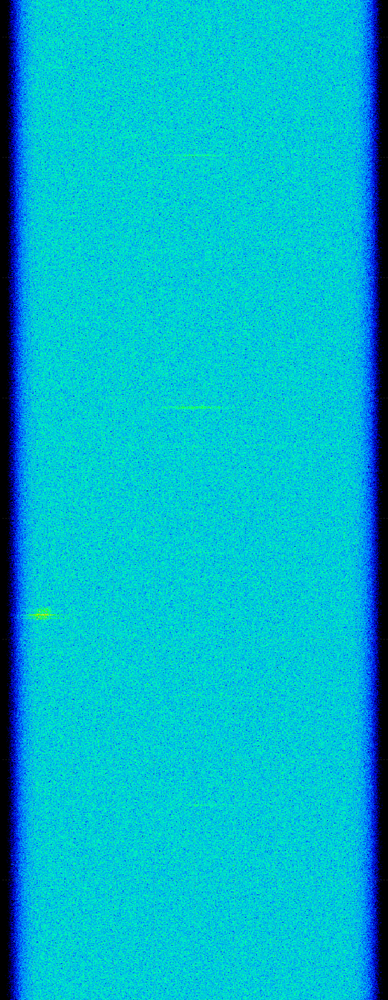

     left_minus_right      mean  middle_max  middle_minus_left  \
206          0.014446  0.461172    0.835714           0.005795   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
206             0.00865            20.0            0.280075      0.835714   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
206        0.342857         128.0           128.0    221.428471  


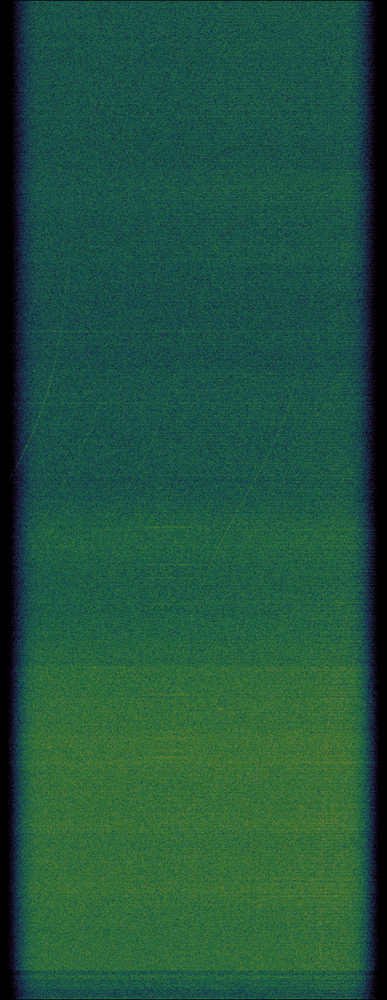

    left_minus_right      mean  middle_max  middle_minus_left  \
28          0.026232  0.740807    0.995575           0.003509   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
28            0.022723             3.0            0.096062      0.659292   

    middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
28        0.278761         226.0           155.0    242.927737  


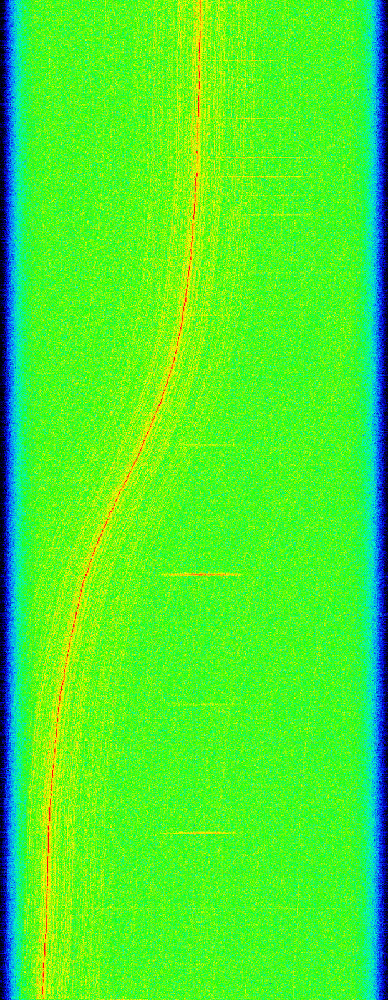

     left_minus_right      mean  middle_max  middle_minus_left  \
213          0.003038  0.646266    0.878049           0.000386   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
213            0.002652             0.0            0.006507      0.878049   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
213        0.219512         123.0           123.0     42.507462  


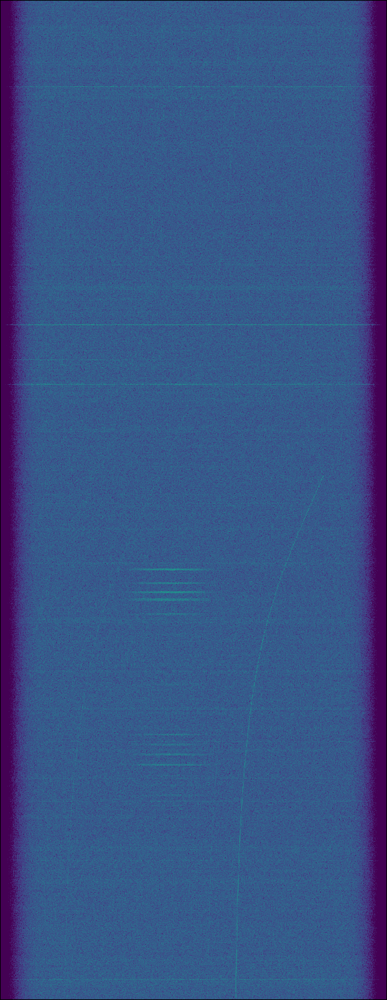

In [22]:
is_false_negative = np.where(np.logical_and(y == 1, y_pred == 0))[0]
for idx in np.random.choice(is_false_negative, 5):
    print(X.iloc[[idx]])
    printWaterfall('../data/cropped/good/' + imgNames[idx])

     left_minus_right      mean  middle_max  middle_minus_left  \
114          0.017294  0.710939    0.977401           0.009114   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
114             0.00818            11.0            0.175531      0.734463   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
114        0.531073         174.0           160.0    358.810191  


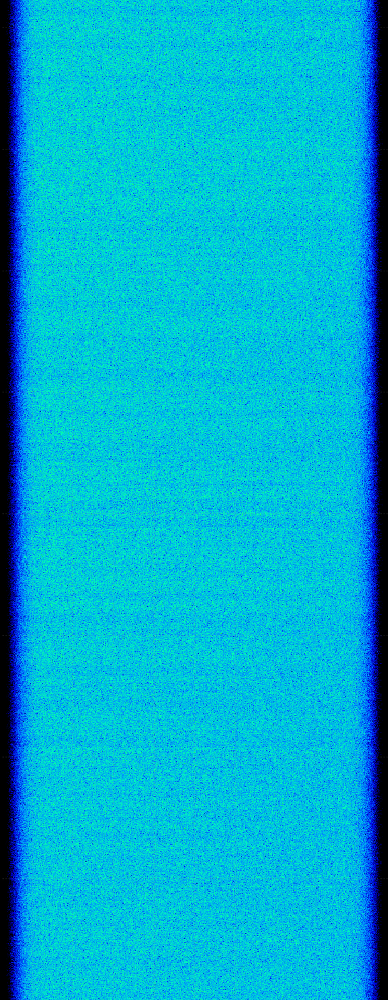

    left_minus_right     mean  middle_max  middle_minus_left  \
28          0.001896  0.00745      0.7375            0.00197   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
28            0.000074            22.0            0.266344        0.7375   

    middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
28          0.7375          80.0            80.0     11.419877  


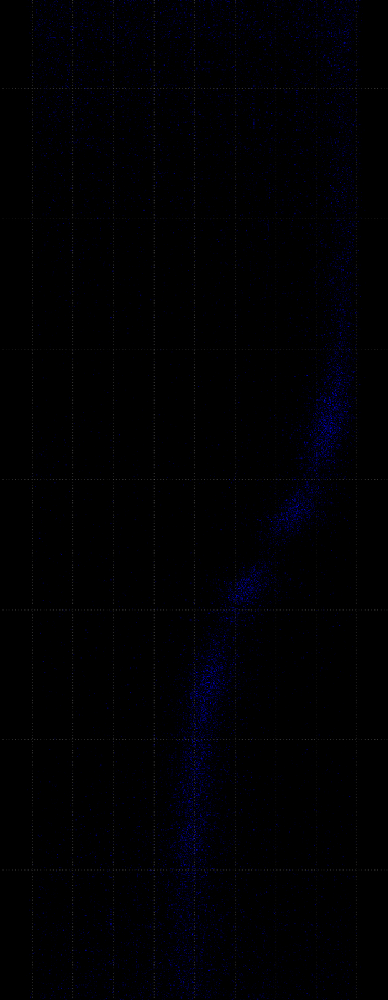

     left_minus_right      mean  middle_max  middle_minus_left  \
138          0.009877  0.739085    0.995575           0.000368   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
138             0.00951             5.0            0.070125      0.663717   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
138        0.314159         226.0           160.0    199.198829  


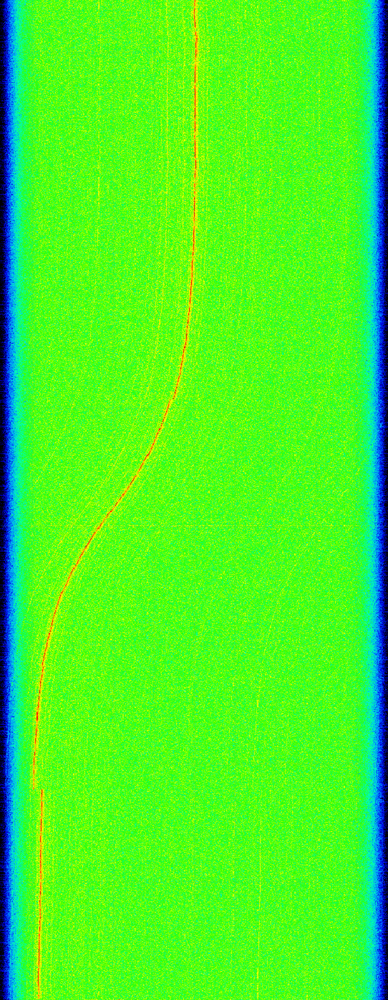

     left_minus_right      mean  middle_max  middle_minus_left  \
253          0.001514  0.568921    0.879699           0.001044   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
253             0.00047             6.0            0.020938       0.37594   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
253        0.293233         184.0           100.0     20.529779  


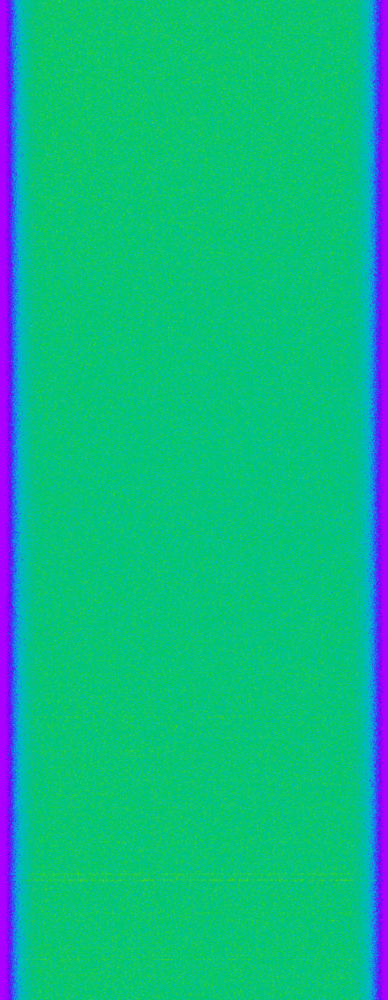

    left_minus_right      mean  middle_max  middle_minus_left  \
89          0.003975  0.652145    0.822222           0.000564   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
89            0.003412             0.0            0.000531      0.506667   

    middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
89        0.333333         207.0           178.0    116.463036  


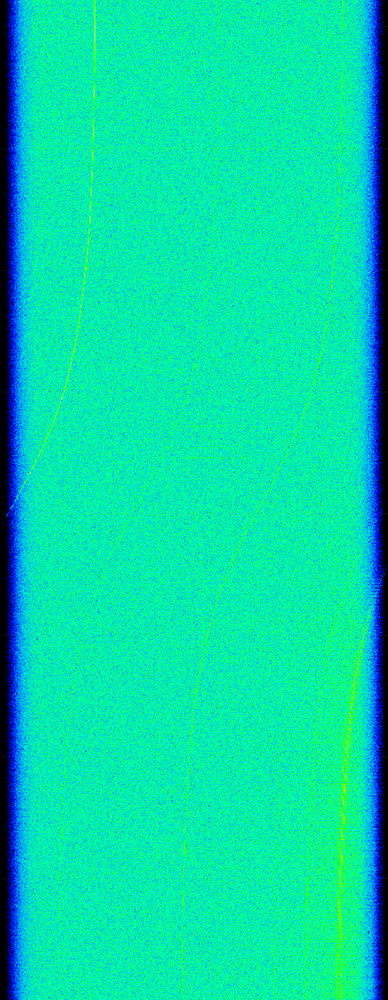

In [24]:
is_false_positive = np.where(np.logical_and(y == 0, y_pred == 1))[0]
for idx in np.random.choice(is_false_positive, 5):
    print(X.iloc[[idx]])
    printWaterfall('../data/cropped/bad/' + imgNames[idx])